<a href="https://colab.research.google.com/github/dimitrivlachos/StellarClassification/blob/main/CM3070_Final_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Exploratory Data Analysis and Pre-processing

First, we need to do some exploratory data analysis. We'll need some tool to analyse the data with as well as our data set.

We'll begin by importing the necessary packages as well as loading our dataset, retrieved from kaggle:
(https://www.kaggle.com/datasets/fedesoriano/stellar-classification-dataset-sdss17 [link text](https://www.kaggle.com/datasets/fedesoriano/stellar-classification-dataset-sdss17))

In [ ]:
import pandas as pd

df = pd.read_csv(r'/content/drive/MyDrive/Documents/CM3070_data/Star99999_raw.csv', index_col=0)
df

,Vmag,Plx,e_Plx,B-V,SpType
0,9.10,3.54,1.39,0.482,F5
1,9.27,21.90,3.10,0.999,K3V
2,6.61,2.81,0.63,-0.019,B9
3,8.06,7.75,0.97,0.370,F0V
4,8.55,2.87,1.11,0.902,G8III
...,...,...,...,...,...
99994,8.72,3.07,0.87,0.097,B3
99995,9.25,,,0.131,A1V
99996,8.08,1.07,0.68,1.094,G5
99997,6.98,2.97,0.76,-0.143,B1.5V


We have 100,000 rows of data. However, it is not ready to be used for training.

The data consists of five columns:

*   **Vmag** - the Visual Apparent Magnitude of the observation.
*   **Plx** - represents the Stellar Parallax, otherwise interpretable as the distance between the observation and the Earth.
*   **e_Plx** - is the standard error of the 'Plx' row.
*   **B-V** - is the B-V colour index.
*   **SpType** - the MK stellar classification, our target.

To prepare our data, we will be following a similar approach as the publisher of the data used (https://www.kaggle.com/code/vinesmsuic/preprocessing-the-stardataset/notebook [link text](https://www.kaggle.com/code/vinesmsuic/preprocessing-the-stardataset/notebook)), except, we will be pre-processing the data into a multi-class dataset, instead of a binary system as their notebook shows.



---



## Pre-processing

The first step in pre-processing this data will be to create a new calculated column, representing the absolute magnitude of the observation.

The absolute magnitude is basically the relative luminosity these objects would appear to be if viewed from the same distance (10 parsecs to be exact).

We calculate the apparent magnitude with the following formula:

\begin{align}
  M = m + 5(\log_{10}(p+1))
\end{align}
Where:
 - M is the apparent magnitude
 - m represents the visual apparent magnitude (Vmag)
 - p represent the stellar parallax (Plx)

Furthermore, we cannot take a log of 0, as this would result in an infinite value. So we must drop rows where Plx = 0.

We also cannot take the log of negative numbers, as this causes complex solutions, which are not feasible. Therefore we will be expanding this drop to any calues <= 0.

We will also be dropping any rows with non-number values, as we have no way to fill in this data and such an observation is completely useless to us.



---



### Dropping null values

First we will drop the null values in the dataset.

In [ ]:
# Check for null values
df.isnull().sum()

Vmag         0
Plx          0
e_Plx        0
B-V          0
SpType    2622
dtype: int64

In [ ]:
# Drop whitespaces

# First we reduce all strings of multiple whitespaces down to 0 using a regex
# as this are present in the data
data_space = df.replace(r'\s+', '', regex = True)

# Then we replace all empty blocks with NaN
data_no_space = data_space.replace('', float('NaN'))

# IMPORTANT:
# Failure to seperate these operations will cause the removal of ALL data
# as it will insert NaN into every block and they will all be dropped next

data_no_space.isnull().sum()

Vmag         1
Plx        231
e_Plx      231
B-V       1128
SpType    2622
dtype: int64

In [ ]:
# Drop null values
data_dropna = data_no_space.dropna()
data_dropna.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 96742 entries, 0 to 99998
Data columns (total 5 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   Vmag    96742 non-null  object
 1   Plx     96742 non-null  object
 2   e_Plx   96742 non-null  object
 3   B-V     96742 non-null  object
 4   SpType  96742 non-null  object
dtypes: object(5)
memory usage: 4.4+ MB


---

Then, we need to go ahead and drop the rows where Plx = 0.

In [ ]:
data_drop_plx = data_dropna.drop(data_dropna[data_dropna.Plx == 0].index)
data_drop_plx.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 96742 entries, 0 to 99998
Data columns (total 5 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   Vmag    96742 non-null  object
 1   Plx     96742 non-null  object
 2   e_Plx   96742 non-null  object
 3   B-V     96742 non-null  object
 4   SpType  96742 non-null  object
dtypes: object(5)
memory usage: 6.4+ MB


---
As we can see, dropping the null values has thrown our index out of alignment. So we need to re-index our rows.

In [ ]:
data_reindex = data_drop_plx.reset_index(drop=True)
data_reindex.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 96742 entries, 0 to 96741
Data columns (total 5 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   Vmag    96742 non-null  object
 1   Plx     96742 non-null  object
 2   e_Plx   96742 non-null  object
 3   B-V     96742 non-null  object
 4   SpType  96742 non-null  object
dtypes: object(5)
memory usage: 3.7+ MB




---



### Calculating Apparent Magnitude (Amag)

Now we can calculate the apparent magnitude of our observations, adding this to the dataframe as an additional column.

In [ ]:
import numpy as np

# Copy over our cleaned data
data = data_reindex.copy()

# Fix data types so that we can run calculations on it
# This also ensures that we have culled all invalid data
data[['Vmag', 'Plx', 'e_Plx', 'B-V']] = data[['Vmag', 'Plx', 'e_Plx', 'B-V']].apply(pd.to_numeric)
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 96742 entries, 0 to 96741
Data columns (total 5 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Vmag    96742 non-null  float64
 1   Plx     96742 non-null  float64
 2   e_Plx   96742 non-null  float64
 3   B-V     96742 non-null  float64
 4   SpType  96742 non-null  object 
dtypes: float64(4), object(1)
memory usage: 3.7+ MB


In [ ]:
# Implement Apparent Magnitude equation as detailed above
data["Amag"] = data["Vmag"] + 5 * (np.log10(abs((data["Plx"])) + 1))

# Note the use of abs() ((Absolute value)) here to prevent taking the
# log of negative numbers as we said we must avoid!

data

,Vmag,Plx,e_Plx,B-V,SpType,Amag
0,9.10,3.54,1.39,0.482,F5,12.385279
1,9.27,21.90,3.10,0.999,K3V,16.069177
2,6.61,2.81,0.63,-0.019,B9,9.514625
3,8.06,7.75,0.97,0.370,F0V,12.770040
4,8.55,2.87,1.11,0.902,G8III,11.488555
...,...,...,...,...,...,...
96737,7.92,3.93,1.24,0.133,Am...,11.384235
96738,8.72,3.07,0.87,0.097,B3,11.767972
96739,8.08,1.07,0.68,1.094,G5,9.659852
96740,6.98,2.97,0.76,-0.143,B1.5V,9.973953




---



## Processing and Analysing categories

Here is where we deviate from the initial notebook. I intend to classify these observations into their MK-categories.

This will also be our first major hurdle as some decisions will need to be made regarding the data which I will cover further ahead.

The MK-classification system has two major axes of classification.

#### Temperature

> **From hottest to coolest:**
> *O, B, A, F, G, K and M.* as well as lesser-known classes such as *D, S and C*
> 
> Which is then ***further subdivided*** within their categories from hottest to coolest using a number (0-9). For example: '*A8*', or '*F0*'.

#### Absolute Magnitude

> Based on the star's absolute magnitude, they are further divided into their sizes using Roman Numerals.
> - 0 or Ia+ is used for *hypergiants*
> - I is for *supergiants*
> - II is for bright *giants*
> - III is for regular *giants*
> - IV is for *subgiants*
> - V is for *main-sequence* stars.
> - VI (or prefixed sd) is for *subdwarfs*
> - VII (or prefixed D) is for *white dwarfs*
>
> Our Sun, for example, is classified as a: '***G2V***', meaning a main-sequence star with a surface temperature of about 5800K.

<img src="https://i.imgur.com/cNBLIpt.png" alt="HR Diagram" width=400/>

This is our first major challenge with the data as, not only do we need to parse the 'SpType' field to pull out the classes, but the field is clearly not uniform.

These types of spectral classes, like many things in the real world, are not clean-cut. The dataset accounts for this and includes very detailed information, such as multiple classes an observation may belong to as well as extra information at the end for various spectral peculiarities. Such as ':' for uncertain values or '!' for special peculiarities.



---

### Dealing with marginal cases

One major hurdle to clean and precise categorisation is that of marginal cases. Some observations do not fit neatly into categories and this is expected. The MK system accounts for this and allows for a few additional symbols to indicate this marginalisation.

> - "/" A slash indicates that a star belongs to *one class or the other*.
> - "-" A dash indicates that a star belongs *between* the two classes.

Lets see how many marginal cases exist in our dataset:

In [ ]:
# Make a copy of our dataset
test_data = data.copy()

# Extract salient data into a new column using a regex
# '(-|\/)' pulls a '-' or a '/' (escaped) from the 'SpType'
test_data['Marginals'] = test_data['SpType'].str.extract(r'(-|\/)')

# Drop rows that do not contain the information we are searching for
test_data.where(test_data.notnull()).dropna()

,Vmag,Plx,e_Plx,B-V,SpType,Amag,Marginals
7,9.05,5.17,1.95,1.102,M6e-M8.5eTc,13.001426,-
20,8.69,4.47,1.15,0.962,G8/K0III/IV,12.379937,/
26,8.83,5.64,1.05,0.468,F3/F5V,12.940840,/
32,6.43,12.71,0.74,0.514,F7.5IV-V,12.115187,-
33,9.07,5.96,1.45,0.916,G8/K0III/IV,13.283046,/
...,...,...,...,...,...,...,...
96699,6.72,17.25,1.77,0.518,F7/G0+F8/G2,13.026314,/
96702,9.98,-1.63,1.34,1.294,M2-M7E(S),12.079779,-
96716,8.69,14.27,1.16,0.522,F6/F7V,14.609195,/
96717,3.58,30.01,0.91,0.883,G6/G8III,11.037509,/


<u>10,023</u> rows of marginalised data. Which accounts for about ~10% of the dataset.

This is a statistically significant portion of the dataset that I would be remiss to remove it all. Instead, for simplicity in this proof of concept, I will simply assign each observation to a category, essentially 'rounding' the data. Since these observations are close enough to either of these classes it should still be feasible to do.

---

### Special peculiarities

Ideally, we would want to account for all axes of categorisation. However, special peculiarities add an additional dimension that our dataset does not contain the necessary information for. Therefore we will need to parse out this additional information.

---

### Formatting data

We need to split the singular 'SpType' category into it's two constituent parts: 'Spectral class' and 'Luminosity class'.

At the same time, we must round marginal cases and drop special peculiarities.

We will do so with regular expressions:

In [ ]:
# Make a copy of our dataset
classified_data = data.copy()

# Extract salient data into a new column using a regex

# Create the regex to extract the spectral class
# This regex extracts the letter-number pair denoting the spectral class
# of the obeservation while also discounting the special case preceding 'D'
# for the luminosity class
spec_regex = r'([OBAFGKMDSC](\d(\.\d)?)(?![OBAFGKMDSC]))'
# Extract data using the regex
classified_data['spectral-class'] = classified_data['SpType'].str.extract(spec_regex)[0]

# Create the regex to extract luminosity classes from the data
# This regex will pull a prefixed 'D' from the spectral class before
# trying to get the proceeding roman numeral instead, which handles all
# luminosity class cases
lum_regex = r'((D(?=[OBAFGKMDSC](\d(\.\d)?)?(?![OBAFGKMDSC])))|(III|II|VII|IV|VI|V|Iab|Ia|Ib|sd))'
# Extract data using the regex
classified_data['luminosity-class'] = classified_data['SpType'].str.extract(lum_regex)[0]

classified_data

,Vmag,Plx,e_Plx,B-V,SpType,Amag,spectral-class,luminosity-class
0,9.10,3.54,1.39,0.482,F5,12.385279,F5,NaN
1,9.27,21.90,3.10,0.999,K3V,16.069177,K3,V
2,6.61,2.81,0.63,-0.019,B9,9.514625,B9,NaN
3,8.06,7.75,0.97,0.370,F0V,12.770040,F0,V
4,8.55,2.87,1.11,0.902,G8III,11.488555,G8,III
...,...,...,...,...,...,...,...,...
96737,7.92,3.93,1.24,0.133,Am...,11.384235,NaN,NaN
96738,8.72,3.07,0.87,0.097,B3,11.767972,B3,NaN
96739,8.08,1.07,0.68,1.094,G5,9.659852,G5,NaN
96740,6.98,2.97,0.76,-0.143,B1.5V,9.973953,B1.5,V


Now that we have the categories in a much more workable format, we can check for new null values:

In [ ]:
classified_data.isnull().sum()

Vmag                    0
Plx                     0
e_Plx                   0
B-V                     0
SpType                  0
Amag                    0
spectral-class       2528
luminosity-class    49161
dtype: int64

It would seem that about half of our dataset does not contain information for a luminosity class.

We can confirm this by looking at the table data and inspecting the 'SpType' field, manually:

In [ ]:
classified_data[pd.isnull(classified_data).any(axis=1)] # Show rows with NaN values

,Vmag,Plx,e_Plx,B-V,SpType,Amag,spectral-class,luminosity-class
0,9.10,3.54,1.39,0.482,F5,12.385279,F5,NaN
2,6.61,2.81,0.63,-0.019,B9,9.514625,B9,NaN
6,9.64,17.74,1.30,0.740,G0,16.003848,G0,NaN
7,9.05,5.17,1.95,1.102,M6e-M8.5eTc,13.001426,M6,NaN
8,8.59,4.81,0.99,1.067,G5,12.410881,G5,NaN
...,...,...,...,...,...,...,...,...
96734,7.62,2.29,0.55,0.097,A0,10.205979,A0,NaN
96735,7.95,2.04,1.25,0.348,A5,10.364368,A5,NaN
96737,7.92,3.93,1.24,0.133,Am...,11.384235,NaN,NaN
96738,8.72,3.07,0.87,0.097,B3,11.767972,B3,NaN


Clearly, these rows do not contain any information on luminosity class and as such, are not useful for training our model.

In [ ]:
# Drop newly defined null data
culled_data = classified_data.dropna()

# Re-index the culled dataset
culled_data = culled_data.reset_index(drop=True)
culled_data

,Vmag,Plx,e_Plx,B-V,SpType,Amag,spectral-class,luminosity-class
0,9.27,21.90,3.10,0.999,K3V,16.069177,K3,V
1,8.06,7.75,0.97,0.370,F0V,12.770040,F0,V
2,8.55,2.87,1.11,0.902,G8III,11.488555,G8,III
3,12.31,18.80,4.99,1.336,M0V:,18.793326,M0,V
4,8.59,10.76,1.10,0.489,F6V,13.942037,F6,V
...,...,...,...,...,...,...,...,...
47510,8.79,0.89,1.28,1.194,K1III,10.172309,K1,III
47511,8.00,0.41,0.92,0.854,F6Iab,8.746096,F6,Iab
47512,7.69,6.60,0.92,1.110,K2III,12.094068,K2,III
47513,6.98,2.97,0.76,-0.143,B1.5V,9.973953,B1.5,V


Now we need to drop rows where ```e_Plx``` is too high.

In [ ]:
culled_data.describe()

,Vmag,Plx,e_Plx,B-V,Amag
count,47515.000000,47515.000000,47515.000000,47515.000000,47515.000000
mean,7.960476,7.638398,1.125113,0.692530,11.880497
std,1.313301,12.738344,0.818645,0.501724,1.923694
min,-0.620000,-27.840000,0.380000,-0.400000,3.768353
25%,7.240000,2.580000,0.800000,0.314000,10.622026
50%,8.200000,4.810000,0.990000,0.616000,11.696923
75%,8.865000,8.890000,1.250000,1.077000,13.146569
max,12.850000,772.330000,40.630000,3.440000,25.451824


In [ ]:
accurate_data = culled_data.drop(culled_data[culled_data.e_Plx >= 1].index)
accurate_data = accurate_data.reset_index(drop=True)
accurate_data.describe()

,Vmag,Plx,e_Plx,B-V,Amag
count,23850.000000,23850.000000,23850.000000,23850.000000,23850.000000
mean,7.264704,7.993403,0.787838,0.666048,11.295012
std,1.261244,11.261522,0.133328,0.545940,1.731617
min,-0.620000,-1.960000,0.380000,-0.310000,3.768353
25%,6.480000,2.810000,0.690000,0.155000,10.211209
50%,7.450000,5.045000,0.800000,0.579000,11.193011
75%,8.170000,9.190000,0.900000,1.100000,12.332357
max,10.110000,392.400000,0.990000,3.440000,20.903404


In [ ]:
# Revert back to using the 'data' variable for ease of reading further down
data = accurate_data.copy()

In [ ]:
# EXTRA CODE FOR DEBUGGING - TODO: REMOVE
#data.describe()
(data.e_Plx >= 1).sum()
#classified_data.loc[classified_data['luminosity-class'] == 'VII'] # Match items in row
#classified_data.loc[classified_data['spectral-class'] == 'K']
#test_data[pd.isnull(test_data).any(axis=1)] # Displays rows with null values
#([OBAFGKMDSC][0-9](\.[0-9])?)*
#([OBAFGKMDSC]\d(\.\d)?)(III|II|VII|IV|VI|V|I)

0

---

## Preparing for training

Now that our data is clean and coherent, we can convert it into a format adequate for training and split it into training, target and validation sets.

### Utility functions
To do this, we will need some utility functions that will convert our classes from the human-readable system into a linear scale that the neural network can understand and then back into the human-readable form at the end.


In [ ]:
import re

In [ ]:
# Define global lists of spectral and luminosty classes
spectral_class_list = ['O','B','A','F','G','K','M','D','S','C']
luminosity_class_list = ['Ia', 'Iab', 'Ib', 'II', 'III', 'IV', 'V', 'sd', 'VII'] 
# VI = sd
# There are no 'VI' values in the dataset, they are all labelled as 'sd'

In [ ]:
def s_class_to_index(s_class):
  '''
  Converts from spectral class to a tensor index.
  
    Converts from spectral class (such as G6, A4 or B1.5)
    into a numerical value representing location in the tensor input.
  
    Parameters:
      s_class (String): Spectral class to convert.
      For example: "G6", "A4"or "B1.5"
  
    Returns:
      int: Numerical value representing the class location on the scale.
  '''
  # Split the spectral class into letter-number pairs using a regular experssion
  # OBAFGKMDSC = size 10
  regex = "([OBAFGKMDSC])(\d(\.\d)?)"
  match = re.search(regex, s_class)

  # Extract catch-group 1
  letter = match.group(1)
  # Extract catch-group 2
  number = round(float(match.group(2)))# check longer decimals

  spectral_class_index = spectral_class_list.index(letter)

  tensor_index = (spectral_class_index * 10) + number

  return tensor_index

s_class_to_index("D6.5Iab") # Should print "76"

76

In [ ]:
def index_to_s_class(index):
  '''
  Converts from spectral class index to a human-readable representation
  
    Converts from tensor index value into a human-readable representation
    (such as G6, A4 or B1.5)
  
    Parameters:
      index (int): index of spectral class
  
    Returns:
      s_class (String): Spectral class of the index value.
  '''
  # Convert integer value into string so we can use list manipulation
  index_string = str(index)

  # Pull out everything before the last number as this represents the letter
  # portion of the class
  letter_index = int(index_string[:-1])

  # Use this index value to 'lookup' the class in the global class list
  letter = spectral_class_list[letter_index]

  # Pull out the last number, which represents the number portion of the class
  number = int(index_string[-1])

  # Combine the letter-number pair to create a human-readable class
  s_class = str(letter) + str(number)

  # Return the re-built class
  return s_class

index_to_s_class(76) # Should print "D6"

'D6'

In [ ]:
def l_class_to_index(l_class):
  '''
  Converts from luminosity class to a tensor index.
  
    Converts from spectral class (such as Ia, VI or sd)
    into a numerical value representing location in the tensor input.
  
    Parameters:
      s_class (String): Spectral class to convert.
      For example: "Ia", "VI"or "sd"
  
    Returns:
      int: Numerical value representing the class location on the scale.
  '''
  # Use a regular expression to pull the various luminosity classes
  # out of the entire classification string
  regex = "(III|II|VII|IV|VI|V|Iab|Ia|Ib|sd)"
  match = re.search(regex, l_class)

  lum_class = match.group(1)


  luminosity_class_index = luminosity_class_list.index(lum_class)

  return luminosity_class_index

l_class_to_index("D6.5Iab") # Should print "1"

1

In [ ]:
def index_to_l_class(index):
  '''
  Converts from luminosity class index to a human-readable representation
  
    Converts from tensor index value into a human-readable representation
    (such as Ia, VI or sd)
  
    Parameters:
      index (int): index of luminosity class
  
    Returns:
      l_class (String): Luminosity class of the index value.
  '''
  # Ensure the input value is an integer
  index_int = int(index)

  l_class = luminosity_class_list[index_int]

  return l_class

index_to_l_class(1) # Should print "Iab"

'Iab'

In [ ]:
def indices_to_class(s_index, l_index):
  '''
  Converts index values into a spectral class
  
    Converts from tensor index value paits into a human-readable representation
    (such as D6Ia, O3.5VI or B2sd)
  
    Parameters:
      s_index (int): index of spectral class
      l_index (int): index of luminosity class
  
    Returns:
     predicted_class (String): Class category of indices.
  '''
  # Convert both dimensions of the tensor
  s_class = index_to_s_class(s_index)
  l_class = index_to_l_class(l_index)

  # Combine into class
  predicted_class = s_class + l_class

  return predicted_class

indices_to_class(76, 1) # Should print "D6Iab"
# Here we have lost the .5 marginal due to our rounding

'D6Iab'

In [ ]:
# Modified from 3.4.2 DWLP
def vectorize_sequences(index, dimension):
    result = np.zeros(dimension)
    result[index] = 1
    return result

vectorize_sequences(1,4)

array([0., 1., 0., 0.])

---

### Training and target sets

Now we need to use our utility functions to create the training target set which we will use for training and validation.

In [ ]:
data

,Vmag,Plx,e_Plx,B-V,SpType,Amag,spectral-class,luminosity-class
0,8.06,7.75,0.97,0.370,F0V,12.770040,F0,V
1,7.57,12.21,0.95,0.456,F2V,13.174514,F2,V
2,6.28,13.74,0.98,0.763,G3IV,12.122487,G3,IV
3,6.43,12.71,0.74,0.514,F7.5IV-V,12.115187,F7.5,IV
4,8.65,23.84,0.78,0.778,G6V,15.625758,G6,V
...,...,...,...,...,...,...,...,...
23845,3.58,30.01,0.91,0.883,G6/G8III,11.037509,G6,III
23846,5.83,2.10,0.61,0.073,O9V,8.286808,O9,V
23847,8.00,0.41,0.92,0.854,F6Iab,8.746096,F6,Iab
23848,7.69,6.60,0.92,1.110,K2III,12.094068,K2,III


In [ ]:
training_df = data[['Vmag', 'Plx', 'e_Plx', 'B-V', 'Amag']].copy()
training_df

,Vmag,Plx,e_Plx,B-V,Amag
0,8.06,7.75,0.97,0.370,12.770040
1,7.57,12.21,0.95,0.456,13.174514
2,6.28,13.74,0.98,0.763,12.122487
3,6.43,12.71,0.74,0.514,12.115187
4,8.65,23.84,0.78,0.778,15.625758
...,...,...,...,...,...
23845,3.58,30.01,0.91,0.883,11.037509
23846,5.83,2.10,0.61,0.073,8.286808
23847,8.00,0.41,0.92,0.854,8.746096
23848,7.69,6.60,0.92,1.110,12.094068


In [ ]:
target_df = data[['spectral-class', 'luminosity-class']].copy()

target_df['spectral-class'] = target_df['spectral-class'].apply(s_class_to_index)
target_df['spectral-class'] = target_df['spectral-class'].apply(vectorize_sequences, dimension=100)

target_df['luminosity-class'] = target_df['luminosity-class'].apply(l_class_to_index)
target_df['luminosity-class'] = target_df['luminosity-class'].apply(vectorize_sequences, dimension=10)

target_df.iloc[1]

spectral-class      [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...
luminosity-class    [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, ...
Name: 1, dtype: object

In [ ]:
#len(class_list)
#len(luminosity_class_list)
#class_list.index('B') + 1
#target_df['spectral-class'].unique()

---

### Train-test split
Now that we have our data prepared, we can split it into our test-train sets using train_test_split()

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(training_df, target_df, test_size=0.05, random_state=42)

---

# Baseline model
### <u>Step 5 of the DLWP pipeline</u>

Now that we have our data, we can begin to use it. The first step in this process is to develop a model that is better than the baseline. That being: a model that exceeds random chance category assignment and therefore has *statistical power*

This is to show that our model does in fact work, if only barely, and that building such a network is feasible.

## The baseline
Our model will categorise observations based on two axes:
- Spectral class (0-99) (**100** classes)
- Luminosity class (0-9) (**10** classes)

This gives us 1000 possible classes (100 x 10 = 1000)

This means that our baseline to beat is 1 in 1000, or a <u>0.1%</u> accuracy.

## Building the model
The exact size and shape of the model are not particularly important at this stage. In fact, deliberately undersizing the model is part of creating this baseline. What *is* important, is that the model shows statistical power.

We will be going beyond the DLWP pipeline that was covered in our ML module and, instead of using the sequential method of building models, we will be implementing our model using the functional API (Chapter 7, DLWP).

### The Functional API
The benefits of using the functional API over the standard sequential model is that it allows us to build models that are *not sequential*. This model architecture requires having *two heads*, meaning that it has two distinct outputs.

By creating a single model with two outputs rather than two discrete models, we can better train the models to work together to produce a coherent result.

In [ ]:
import tensorflow as tf
from tensorflow import keras
from keras import layers
from keras import Input
from keras.models import Model

In [ ]:
# Create our input layer:
# This is a 5 dimensional tensor, one node for each input.
input = keras.Input(shape=(5), name='observation_data')

# Build our hidden layers:
# These are two, densely connected layers, with 16 dimensions each.
# We are using a very standard relu activation for these
x = layers.Dense(16, activation='relu', name = 'dense_1')(input)
x = layers.Dense(16, activation='relu', name = 'dense_2')(x)

# Create our output layers:
# This is where the model branches into its separate heads.
#
# Each output layer consists of a number of dimensions equal to the number
# of classes the model must classify into.
#
# We use the 'softmax' activation type, as is standard in multi-category
# classification output tensors.

# Spectral class output layer
s_class_prediction = layers.Dense(100, 
                                  activation='softmax', 
                                  name='s_class_prediction')(x)
# Luminosity class output layer
l_class_prediction = layers.Dense(10, 
                                  activation='softmax', 
                                  name='l_class_prediction')(x)

# Now we instantiate our model using the layer setup above
baseline_model = Model(input, [s_class_prediction, l_class_prediction])

This creates a model shaped like:
[INSERT IMAGE]

In [ ]:
# Compile the model:
# We are using categorical_crossentropy as our loss function as is
# standard for multi-class categorisation problems such as this
baseline_model.compile(optimizer='rmsprop',
              loss={'s_class_prediction':'categorical_crossentropy',
                    'l_class_prediction':'categorical_crossentropy'},
              metrics=['accuracy'])

baseline_model.summary()

Model: "model_7"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 observation_data (InputLayer)  [(None, 5)]          0           []                               
                                                                                                  
 dense_1 (Dense)                (None, 16)           96          ['observation_data[0][0]']       
                                                                                                  
 dense_2 (Dense)                (None, 16)           272         ['dense_1[0][0]']                
                                                                                                  
 s_class_prediction (Dense)     (None, 100)          1700        ['dense_2[0][0]']                
                                                                                            

The model requires a tensor as an input and we still have our data in dataframes.

In [ ]:
# Convert training data and targets into tensors
input_data = tf.convert_to_tensor(X_train)

spectral_targets = tf.convert_to_tensor(y_train['spectral-class'].copy().to_list())
luminosity_targets = tf.convert_to_tensor(y_train['luminosity-class'].copy().to_list())

Finally, we train:

In [ ]:
# Load tensorboard so that we can visualise the network
%load_ext tensorboard
#from tensorboard import notebook
#notebook.list() # View open TensorBoard instances

In [ ]:
import os, datetime
#logdir = os.path.join("logs", "Baseline Model")#datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
logdir = os.path.join(r'/content/drive/MyDrive/Documents/CM3070_data/logs', "Baseline Model")
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

baseline_model.fit(
    input_data,{
        's_class_prediction':spectral_targets,
        'l_class_prediction':luminosity_targets
        },
    epochs=20, 
    batch_size=64,
    validation_split=0.1,
    callbacks=[tensorboard_callback])

Epoch 1/20
319/319 [==============================] - 9s 6ms/step - loss: 4.9581 - s_class_prediction_loss: 3.7396 - l_class_prediction_loss: 1.2185 - s_class_prediction_accuracy: 0.0788 - l_class_prediction_accuracy: 0.6173 - val_loss: 4.3221 - val_s_class_prediction_loss: 3.4187 - val_l_class_prediction_loss: 0.9034 - val_s_class_prediction_accuracy: 0.0940 - val_l_class_prediction_accuracy: 0.7017
Epoch 2/20
319/319 [==============================] - 2s 5ms/step - loss: 4.0966 - s_class_prediction_loss: 3.2446 - l_class_prediction_loss: 0.8520 - s_class_prediction_accuracy: 0.1355 - l_class_prediction_accuracy: 0.7255 - val_loss: 3.9663 - val_s_class_prediction_loss: 3.1055 - val_l_class_prediction_loss: 0.8608 - val_s_class_prediction_accuracy: 0.1496 - val_l_class_prediction_accuracy: 0.7140
Epoch 3/20
319/319 [==============================] - 2s 6ms/step - loss: 3.7902 - s_class_prediction_loss: 2.9658 - l_class_prediction_loss: 0.8243 - s_class_prediction_accuracy: 0.1622 - l_c

In [ ]:
#%tensorboard --logdir logs
#notebook.display(port=6006) 

---

# Scaling up
### <u>Step 6 of the DLWP pipeline</u>
Now that we have proven that our model has statistical power, we need to scale it up to determine an upper limit to its size.

We need to determine a point where the model begins overfitting.

There are three ways we can do this:
- increase the size of the layers
- add more layers
- train for more epochs

We will train all of these networks for 500 epochs in order to track their losses. We will also test and compare both wider and deeper networks.

Firstly, we trim the input data to the relevant fields.

In [ ]:
streamlined_training_df = data[['Plx', 'B-V', 'Amag']].copy()

X_train, X_test, y_train, y_test = train_test_split(streamlined_training_df, target_df, test_size=0.05, random_state=42)

# Convert training data and targets into tensors
input_data = tf.convert_to_tensor(X_train)
spectral_targets = tf.convert_to_tensor(y_train['spectral-class'].copy().to_list())
luminosity_targets = tf.convert_to_tensor(y_train['luminosity-class'].copy().to_list())

## A wide approach
This network has layers 500 nodes wide.

In [ ]:
# Create our input layer:
input = keras.Input(shape=(3), name='observation_data')
#normalization = layers.BatchNormalization()(input)

# Build our spectral class
s_class_branch = layers.Dense(500, activation='relu', name = 's_class_branch_dense_1')(input)
s_class_branch = layers.Dense(500, activation='relu', name = 's_class_branch_dense_2')(s_class_branch)
s_class_prediction = layers.Dense(100, 
                                  activation='softmax', 
                                  name='s_class_prediction')(s_class_branch)

# Build our luminosity class
l_class_branch = layers.Dense(500, activation='relu', name = 'l_class_branch_dense_1')(input)
l_class_branch = layers.Dense(100, activation='relu', name = 'l_class_branch_dense_2')(l_class_branch)
l_class_prediction = layers.Dense(10, 
                                  activation='softmax', 
                                  name='l_class_prediction')(l_class_branch)

# Now we instantiate our model using the layer setup above
scaled_model = Model(input, [s_class_prediction, l_class_prediction])

# # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # #

lr_schedule = keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=0.004,
    decay_steps=10,
    decay_rate=0.96)

optimizer = keras.optimizers.RMSprop(learning_rate=0.004)#lr_schedule)#Not using for now

scaled_model.compile(optimizer=optimizer,
              loss={'s_class_prediction':'categorical_crossentropy',
                    'l_class_prediction':'categorical_crossentropy'},
              #loss_weights={'s_class_prediction':10.,
              #              'l_class_prediction':2.},
              metrics=['accuracy'])

# # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # #

#logdir = os.path.join("logs", "Step-6 Wide")#datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
logdir = os.path.join(r'/content/drive/MyDrive/Documents/CM3070_data/logs', "Step-6 Wide")
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

scaled_model.fit(
    input_data,{
        's_class_prediction':spectral_targets,
        'l_class_prediction':luminosity_targets
        },
    epochs=500, 
    batch_size=1000,
    validation_split=0.1,
    callbacks=[tensorboard_callback])

Epoch 1/500
21/21 [==============================] - 1s 26ms/step - loss: 5.5722 - s_class_prediction_loss: 3.9344 - l_class_prediction_loss: 1.6379 - s_class_prediction_accuracy: 0.0849 - l_class_prediction_accuracy: 0.5000 - val_loss: 4.6444 - val_s_class_prediction_loss: 3.3098 - val_l_class_prediction_loss: 1.3346 - val_s_class_prediction_accuracy: 0.1103 - val_l_class_prediction_accuracy: 0.5649
Epoch 2/500
21/21 [==============================] - 0s 13ms/step - loss: 4.1803 - s_class_prediction_loss: 3.1293 - l_class_prediction_loss: 1.0510 - s_class_prediction_accuracy: 0.1212 - l_class_prediction_accuracy: 0.6056 - val_loss: 4.0278 - val_s_class_prediction_loss: 2.9690 - val_l_class_prediction_loss: 1.0588 - val_s_class_prediction_accuracy: 0.1306 - val_l_class_prediction_accuracy: 0.6249
Epoch 3/500
21/21 [==============================] - 0s 13ms/step - loss: 3.8588 - s_class_prediction_loss: 2.9090 - l_class_prediction_loss: 0.9498 - s_class_prediction_accuracy: 0.1421 - l_c

We extend this to have a width of 5000 nodes

In [ ]:
# Create our input layer:
input = keras.Input(shape=(3), name='observation_data')
#normalization = layers.BatchNormalization()(input)

# Build our spectral class
s_class_branch = layers.Dense(5000, activation='relu', name = 's_class_branch_dense_1')(input)
s_class_branch = layers.Dense(500, activation='relu', name = 's_class_branch_dense_2')(s_class_branch)
s_class_prediction = layers.Dense(100, 
                                  activation='softmax', 
                                  name='s_class_prediction')(s_class_branch)

# Build our luminosity class
l_class_branch = layers.Dense(1000, activation='relu', name = 'l_class_branch_dense_1')(input)
l_class_branch = layers.Dense(100, activation='relu', name = 'l_class_branch_dense_2')(l_class_branch)
l_class_prediction = layers.Dense(10, 
                                  activation='softmax', 
                                  name='l_class_prediction')(l_class_branch)

# Now we instantiate our model using the layer setup above
scaled_model = Model(input, [s_class_prediction, l_class_prediction])

# # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # #

lr_schedule = keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=0.004,
    decay_steps=10,
    decay_rate=0.96)

optimizer = keras.optimizers.RMSprop(learning_rate=0.004)#lr_schedule)#Not using for now

scaled_model.compile(optimizer=optimizer,
              loss={'s_class_prediction':'categorical_crossentropy',
                    'l_class_prediction':'categorical_crossentropy'},
              #loss_weights={'s_class_prediction':10.,
              #              'l_class_prediction':2.},
              metrics=['accuracy'])

# # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # #

#logdir = os.path.join("logs", "Step-6 Extra Wide")#datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
logdir = os.path.join(r'/content/drive/MyDrive/Documents/CM3070_data/logs', "Step-6 Extra Wide")
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

scaled_model.fit(
    input_data,{
        's_class_prediction':spectral_targets,
        'l_class_prediction':luminosity_targets
        },
    epochs=500, 
    batch_size=1000,
    validation_split=0.1,
    callbacks=[tensorboard_callback])

Epoch 1/500
21/21 [==============================] - 2s 50ms/step - loss: 6.9801 - s_class_prediction_loss: 5.1156 - l_class_prediction_loss: 1.8645 - s_class_prediction_accuracy: 0.0836 - l_class_prediction_accuracy: 0.4803 - val_loss: 4.1933 - val_s_class_prediction_loss: 3.1398 - val_l_class_prediction_loss: 1.0535 - val_s_class_prediction_accuracy: 0.1218 - val_l_class_prediction_accuracy: 0.6293
Epoch 2/500
21/21 [==============================] - 1s 42ms/step - loss: 4.1879 - s_class_prediction_loss: 3.1708 - l_class_prediction_loss: 1.0171 - s_class_prediction_accuracy: 0.1176 - l_class_prediction_accuracy: 0.6312 - val_loss: 3.7908 - val_s_class_prediction_loss: 2.8984 - val_l_class_prediction_loss: 0.8923 - val_s_class_prediction_accuracy: 0.1447 - val_l_class_prediction_accuracy: 0.6942
Epoch 3/500
21/21 [==============================] - 1s 44ms/step - loss: 3.9079 - s_class_prediction_loss: 2.9809 - l_class_prediction_loss: 0.9270 - s_class_prediction_accuracy: 0.1410 - l_c

## A deep approach

This network goes 4 layers deep in either head.

In [ ]:
# Create our input layer:
input = keras.Input(shape=(3), name='observation_data')
#normalization = layers.BatchNormalization()(input)

# Build our spectral class
s_class_branch = layers.Dense(6, activation='relu', name = 's_class_branch_dense_1')(input)
s_class_branch = layers.Dense(300, activation='relu', name = 's_class_branch_dense_2')(s_class_branch)
s_class_branch = layers.Dense(100, activation='relu', name = 's_class_branch_dense_3')(s_class_branch)
s_class_branch = layers.Dense(500, activation='relu', name = 's_class_branch_dense_4')(s_class_branch)

s_class_prediction = layers.Dense(100, 
                                  activation='softmax', 
                                  name='s_class_prediction')(s_class_branch)

# Build our luminosity class
l_class_branch = layers.Dense(6, activation='relu', name = 'l_class_branch_dense_1')(input)
l_class_branch = layers.Dense(150, activation='relu', name = 'l_class_branch_dense_2')(l_class_branch)
l_class_branch = layers.Dense(100, activation='relu', name = 'l_class_branch_dense_3')(l_class_branch)
l_class_branch = layers.Dense(100, activation='relu', name = 'l_class_branch_dense_4')(l_class_branch)
l_class_prediction = layers.Dense(10, 
                                  activation='softmax', 
                                  name='l_class_prediction')(l_class_branch)

# Now we instantiate our model using the layer setup above
scaled_model = Model(input, [s_class_prediction, l_class_prediction])

# # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # #

lr_schedule = keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=0.004,
    decay_steps=10,
    decay_rate=0.96)

optimizer = keras.optimizers.RMSprop(learning_rate=0.004)#lr_schedule)#Not using for now

scaled_model.compile(optimizer=optimizer,
              loss={'s_class_prediction':'categorical_crossentropy',
                    'l_class_prediction':'categorical_crossentropy'},
              #loss_weights={'s_class_prediction':10.,
              #              'l_class_prediction':2.},
              metrics=['accuracy'])

# # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # #

#logdir = os.path.join("logs", "Step-6 Deep")#datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
logdir = os.path.join(r'/content/drive/MyDrive/Documents/CM3070_data/logs', "Step-6 Deep")
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

scaled_model.fit(
    input_data,{
        's_class_prediction':spectral_targets,
        'l_class_prediction':luminosity_targets
        },
    epochs=500, 
    batch_size=1000,
    validation_split=0.1,
    callbacks=[tensorboard_callback])

Epoch 1/500
21/21 [==============================] - 2s 38ms/step - loss: 5.1479 - s_class_prediction_loss: 3.7187 - l_class_prediction_loss: 1.4292 - s_class_prediction_accuracy: 0.0741 - l_class_prediction_accuracy: 0.4655 - val_loss: 4.7159 - val_s_class_prediction_loss: 3.5653 - val_l_class_prediction_loss: 1.1506 - val_s_class_prediction_accuracy: 0.0706 - val_l_class_prediction_accuracy: 0.5984
Epoch 2/500
21/21 [==============================] - 0s 19ms/step - loss: 4.5651 - s_class_prediction_loss: 3.4936 - l_class_prediction_loss: 1.0715 - s_class_prediction_accuracy: 0.0824 - l_class_prediction_accuracy: 0.5907 - val_loss: 4.5101 - val_s_class_prediction_loss: 3.4780 - val_l_class_prediction_loss: 1.0321 - val_s_class_prediction_accuracy: 0.0763 - val_l_class_prediction_accuracy: 0.6033
Epoch 3/500
21/21 [==============================] - 0s 18ms/step - loss: 4.4419 - s_class_prediction_loss: 3.4557 - l_class_prediction_loss: 0.9862 - s_class_prediction_accuracy: 0.0854 - l_c

In [ ]:
#%tensorboard --logdir logs
#%tensorboard --logdir drive/MyDrive/Documents/CM3070_data/logs

Reusing TensorBoard on port 6007 (pid 151816), started 0:13:28 ago. (Use '!kill 151816' to kill it.)

<IPython.core.display.Javascript object>

---

# Hyperparameter optimisation
### <u>Step 7 of the DLWP pipeline</u>

Now that we have a general guideline for what bounds the model, we need to optimise and fine-tune the ideal architecture.

To do this, we will have to build and test a series of varied architectures. The following helper functions will allow for dynamic generation of model architectures:

In [ ]:
import tensorflow as tf
from tensorflow.keras import layers, Model, Input, regularizers
import os
from sklearn.model_selection import train_test_split
%load_ext tensorboard

## Utility functions
First, I create a CustomCallback so that the training process of multiple networks is easier to visualise and monitor:

In [ ]:
# Code from (University of London, 2022)
class CustomCallback(tf.keras.callbacks.Callback):
  '''
  Adds a simple spinner while training for visualisation purposes
  '''
  def on_epoch_begin(self, epoch, logs=None):
    c = ['\b|', '\b/', '\b-', '\b\\']
    print(c[epoch % 4], end='')
  def on_epoch_end(self, epoch, logs=None):
    print('', end='')

Then a function to build a set of layers. We need to test a number of factors:
- The number of layers
- The layer size 
- If normalization is needed
- If dropout is needed
- If regularization is needed

Each of these require series of layers and this function allows us to build these 'sets' of layers.

In [ ]:
def build_layer(
    input_layer, 
    layer_size, 
    normalization, 
    dropout_rate, 
    regularizer
    ):
  '''
  Build a predefined set of neural network layers.

  Parameters
  ----------
  input_layer: Tensor. The input layer of the neural network.
  layer_size: int. An integer specifying the number of neurons for the layer.
  normalization: Boolean. Whether to apply batch normalization to the output of each layer.
  dropout_rate: Float. The dropout rate to be applied to the output of each layer.
  regularizer: Regularizer. A Keras regularizer object to be applied to the kernel weights of each layer (default=None).

  Returns
  -------
  Tensor. The output layer of the fully-connected neural network.
  '''
  # Set the initial layer
  x = input_layer

  x = layers.Dense(layer_size, activation='relu', kernel_regularizer=regularizer)(x)
  # Apply batch normalization if normalization is True
  if (normalization):
    x = layers.BatchNormalization()(x)
  # Apply dropout if dropout_rate is greater than 0
  if (dropout_rate):
    x = layers.Dropout(dropout_rate)(x)

  # Return the output layer
  return x

We also need to see if splitting the model earlier, or later improves results. This is what the 'base size' paramater controls. This function utilises the layer builder to create a full, double-headed model.

In [ ]:
def build_model(
    base_size,
    s_layers,
    l_layers,
    normalization = False,
    dropout_rate = 0,
    regularizer = None,
    ):
  '''
  Build a neural network model for predicting spectral and luminosity classes.

  Parameters
  ----------
  base_size: Integer. The number of neurons for the base layer of the neural network (A value of 0 will result in no base layer being created).
  s_layers: List[int]. A list integers specifying the number of neurons for each layer in the spectral class head.
  l_layers: List[int]. A list integers specifying the number of neurons for each layer in the luminosity class head.
  normalization: Boolean. Whether to apply batch normalization to the input and output of each layer (default=False).
  dropout_rate: Float. The dropout rate to be applied to the output of each layer (A value of 0 will result in no dropout being used).
  regularizer: Regularizer. A Keras regularizer object to be applied to the kernel weights of each layer (default=None).

  Returns
  -------
  A Keras model with two output layers for predicting the spectral class and luminosity class of astronomical objects.
  '''
  # Create our input layer:
  i = tf.keras.Input(shape=(3), name='input')
  if(normalization):
    i = keras.layers.BatchNormalization()(i)

  # Define base section of network (if any)
  if (base_size):
    i = keras.layers.Dense(base_size, activation='relu', kernel_regularizer = regularizer, name = 'base_layer')(i)
    if(normalization):
      i = keras.layers.BatchNormalization()(i)
    if(dropout_rate):
      i = keras.layers.Dropout(dropout_rate)(i)

  # Build our spectral class head
  for layer_size in s_layers:
    s = build_layer(i, layer_size, normalization, dropout_rate, regularizer)

  s_class_prediction = keras.layers.Dense(100, 
                                    activation='softmax', 
                                    name='s_class_prediction')(s)

  # Build our luminosity class head
  for layer_size in l_layers:
    l = build_layer(i, layer_size, normalization, dropout_rate, regularizer)

  l_class_prediction = keras.layers.Dense(10, 
                                    activation='softmax', 
                                    name='l_class_prediction')(l)

  # Now we instantiate our model using the layer setup above
  model = Model(i, [s_class_prediction, l_class_prediction])
  return model

This function takes the model we built and compiles it. Here we can modify two more parameters:
- head_weight: The weighting of either head while training. This is a value between 0 and 1 (exclusive) Where one head will have the weight ```head_weight``` and the other will have the weight ```1 - head_weight```
- learning_rate_decay: This allows us o set the learning rate to a fixed value or use an exponential decay callback.

In [ ]:
def compile_model(
    model,
    head_weight = 0.5,
    learning_rate_decay = False,
):
  '''
  Compile a Keras model for predicting spectral and luminosity classes.

  Parameters
  ----------
  model (tf.keras.models.Model): A Keras model object to be compiled.
  head_weight: Float. The weighting of either head while training. This is a value between 0 and 1 (exclusive) Where one head will have the weight ```head\_weight``` and the other will have the weight ```1\ -\ head_weight```.
  learning_rate_decay: Boolean. Whether to apply exponential decay to the learning rate of the RMSprop optimizer (default=False).

  Returns
  -------
  A Keras model object that has been compiled with the specified optimizer, loss functions, loss weights, and metrics.
  '''
  # Set optimizer type to use
  if(learning_rate_decay):
    optimizer = keras.optimizers.RMSprop(learning_rate=0.004)
  else:
    lr_schedule = keras.optimizers.schedules.ExponentialDecay(
      initial_learning_rate=0.004,
      decay_steps=10,
      decay_rate=0.96)
    
    optimizer = keras.optimizers.RMSprop(learning_rate=lr_schedule)

  # Compile the model with the chosen optimizer and loss weights
  model.compile(optimizer=optimizer,
                loss={'s_class_prediction':'categorical_crossentropy',
                      'l_class_prediction':'categorical_crossentropy'},
                loss_weights={'s_class_prediction':head_weight,
                              'l_class_prediction':1-head_weight},
                metrics=['accuracy'])
  # Return compiled model
  return model

Finally, a function to train the models that we create. This allows us to further fine-tune our hyperparameters, controlling the number of epochs trained and the batch size.

Batch size is the only value we really care about here, as we want to train for enough epochs to overfit. We can later use the logs to find the optimal epoch length for the final step.

In [ ]:
# Code adapted from (University of London, 2022) and (Chollet, 2017)
def train_model(model,
                name = "Model" ,
                epochs = 200,
                batch_size = 512,
                verbose = 0):
  '''
  Trains a Keras model using the processed data for spectral and luminosity classifications.

  Parameters
  ----------
  model (tf.keras.models.Model): A Keras model to be trained.
  name: String. The name of the model to save into the logs
  epochs: Integer. The number of times to iterate over the entire training dataset.
  batch_size: Integer. The number of samples to use in one forward/backward pass.
  verbose: Integer. An integer that specifies the verbosity mode (0=silent, 1=progress bar, 2=one line per epoch).

  Returns
  -------
  A `history` object that contains the training loss and accuracy for each epoch.
  '''
  logdir = os.path.join(r'/content/drive/MyDrive/Documents/CM3070_data/final_logs', name)
  tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

  history = model.fit(
      input_data,{
          's_class_prediction':spectral_targets,
          'l_class_prediction':luminosity_targets,
          },
      epochs=epochs, 
      batch_size=batch_size,
      verbose=verbose,
      validation_split=0.1,
      callbacks=[CustomCallback(), tensorboard_callback])
  return history

## Hyperparameter space search

In [ ]:
%tensorboard --logdir drive/MyDrive/Documents/CM3070_data/final_logs

<IPython.core.display.Javascript object>

In [ ]:
# An empty dict to store our histories in
#histories = {}

# List of parameter permutations to search
base_sizes = [0, 10, 25]
s_head_sizes = [[10, 50, 50], [10, 50, 50, 50], [10, 50, 50, 50, 50, 50], [25,150,150], [25,150,150,150], [50,300,300], [50,300,300,300]]
l_head_sizes = [[10, 50, 50], [10, 50, 50, 50], [10, 50, 50, 50, 50, 50], [25,150,150], [25,150,150,150], [50,300,300], [50,300,300,300]]
normalizations = [True, False]
dropout_rates = [0, 0.1, 0.25]
regularizers_list = [None, regularizers.l1(1e-3), regularizers.l2(1e-3), regularizers.l1_l2(1e-3)]
regularizer_names = ("None", "L1", "L2", "L1L2")
head_weights = [0.25, 0.5, 0.75]
learning_rate_decays = [True, False]

# # # # # # # # # # # # # # # # # # # #

# Loop through and test all listed combinations of hyperparameters
for base_size in base_sizes:
  for i, (s_size, l_size) in enumerate(zip(s_head_sizes, l_head_sizes)):
    for normalization in normalizations:
      for dropout_rate in dropout_rates:
        for regularizer, regularizer_name in zip(regularizers_list, regularizer_names):
          for head_weight in head_weights:
            for learning_rate_decay in learning_rate_decays:
              # Create identifying name
              name  = "B=" + str(base_size) + "_"
              name += "S=" + str(i) + "_"
              name += "N=" + str(normalization) + "_"
              name += "DP=" + str(dropout_rate) + "_"
              name += "R=" + regularizer_name + "_"
              name += "HW=" + str(head_weight) + "_"
              name += "LR=" + str(learning_rate_decay)

              print("Training:", name, "\t")
              
              model = build_model(base_size, s_size, l_size, normalization, dropout_rate, regularizer)
              model = compile_model(model, head_weight, learning_rate_decay)
              history = train_model(model, name)

              # Remove the spinny after the experiment
              print("\b")

              #histories[name] = history

|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\|/-\

FailedPreconditionError: ignored

---
V OLD TO DELETE V

In [ ]:
def create_model(x_train, y_train, x_test, y_test):

  input_data = tf.convert_to_tensor(x_train)
  spectral_targets = tf.convert_to_tensor(y_train['spectral-class'].copy().to_list())
  luminosity_targets = tf.convert_to_tensor(y_train['luminosity-class'].copy().to_list())

  dropout_rate = {{uniform(0.0, 0.5)}}
  layers = {{choice(['three', 'four'])}}
  regularizer = {{choice(['None', 'L1', 'L2', 'L1L2'])}}
  l_weights = {{uniform(0.1, 0.9)}}

  # Create our input layer:
  i = tf.keras.Input(shape=(3), name='observation_data')
  i = keras.layers.BatchNormalization()(i)

  if ({{choice(['base', 'no_base'])}} == 'base'):
    i = keras.layers.Dense({{choice([10, 25, 50])}}, activation='relu', kernel_regularizer = regularizer, name = 'base_layer')(i)
    i = keras.layers.BatchNormalization()(i)
    i = keras.layers.Dropout(dropout_rate)(i)

  # Build our spectral class
  s = keras.layers.Dense({{choice([10, 25, 50])}}, activation='relu', kernel_regularizer = regularizer, name = 's_class_branch_dense_1')(i)
  s = keras.layers.BatchNormalization()(s)
  s = keras.layers.Dropout(dropout_rate)(s)

  s = keras.layers.Dense({{choice([50, 150, 300])}}, activation='relu', kernel_regularizer = regularizer, name = 's_class_branch_dense_2')(s)
  s = keras.layers.BatchNormalization()(s)
  s = keras.layers.Dropout(dropout_rate)(s)

  s = keras.layers.Dense({{choice([50, 150, 300])}}, activation='relu', kernel_regularizer = regularizer, name = 's_class_branch_dense_3')(s)
  s = keras.layers.BatchNormalization()(s)
  s = keras.layers.Dropout(dropout_rate)(s)

  if (layers == 'four'):
    s = keras.layers.Dense({{choice([50, 150, 300])}}, activation='relu', kernel_regularizer = regularizer, name = 's_class_branch_dense_4')(s)
    s = keras.layers.BatchNormalization()(s)
    s = keras.layers.Dropout(dropout_rate)(s)

  s_class_prediction = keras.layers.Dense(100, 
                                    activation='softmax', 
                                    name='s_class_prediction')(s)

  # Build our luminosity class
  l = keras.layers.Dense({{choice([10, 25, 50])}}, activation='relu', kernel_regularizer = regularizer, name = 'l_class_branch_dense_1')(i)
  l = keras.layers.BatchNormalization()(l)
  l = keras.layers.Dropout(dropout_rate)(l)

  l = keras.layers.Dense({{choice([50, 150, 300])}}, activation='relu', kernel_regularizer = regularizer, name = 'l_class_branch_dense_2')(l)
  l = keras.layers.BatchNormalization()(l)
  l = keras.layers.Dropout(dropout_rate)(l)

  l = keras.layers.Dense({{choice([50, 150, 300])}}, activation='relu', kernel_regularizer = regularizer, name = 'l_class_branch_dense_3')(l)
  l = keras.layers.BatchNormalization()(l)
  l = keras.layers.Dropout(dropout_rate)(l)

  if (layers == 'four'):
    l = keras.layers.Dense({{choice([50, 150, 300])}}, activation='relu', kernel_regularizer = regularizer, name = 'l_class_branch_dense_4')(l)
    l = keras.layers.BatchNormalization()(l)
    l = keras.layers.Dropout(dropout_rate)(l)

  l_class_prediction = keras.layers.Dense(10, 
                                    activation='softmax', 
                                    name='l_class_prediction')(l)

  # Now we instantiate our model using the layer setup above
  optimised_model = Model(i, [s_class_prediction, l_class_prediction])

  # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # #

  lr_schedule = keras.optimizers.schedules.ExponentialDecay(
      initial_learning_rate=0.004,
      decay_steps=10,
      decay_rate=0.96)

  if({{choice(['0.004', 'lr_schedule'])}} == '0.004'):
    optimizer = keras.optimizers.RMSprop(learning_rate=0.004)
  else:
    optimizer = keras.optimizers.RMSprop(learning_rate=lr_schedule)



  optimised_model.compile(optimizer=optimizer,
                loss={'s_class_prediction':'categorical_crossentropy',
                      'l_class_prediction':'categorical_crossentropy'},
                loss_weights={'s_class_prediction':l_weights,
                              'l_class_prediction':1-l_weights},
                metrics=['accuracy'])

  # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # #

  result = optimised_model.fit(
      input_data,{
          's_class_prediction':spectral_targets,#y_train[:,0],
          'l_class_prediction':luminosity_targets,#y_train[:,1]
          },
      epochs=200, 
      batch_size={{choice([128, 512, 1024])}},
      validation_split=0.1)
  
  validation_acc = np.amax(result.history['val_acc'])
  print('Best validation acc of epoch:', validation_acc)
  return {'loss': -validation_acc, 'status': STATUS_OK, 'model': optimised_model}

In [ ]:
%tensorboard --logdir logs

---

In [ ]:
unknown_star = ((8.79, 0.89, 1.28, 1.194, 10.172309),)

def predict(model, params):
  input_tensor = tf.convert_to_tensor(params)

  prediction = model.predict(input_tensor)

  spectral_class_prediction = prediction[0][0]
  s_max = max(spectral_class_prediction)
  s_prediction_index = np.where(spectral_class_prediction == s_max)[0][0]
  s_final_prediction = index_to_s_class(s_prediction_index)

  luminosity_class_prediction = prediction[1][0]
  l_max = max(luminosity_class_prediction)
  l_prediction_index = np.where(luminosity_class_prediction == l_max)[0][0]
  l_final_prediction = index_to_l_class(l_prediction_index)

  predicted_class = s_final_prediction + l_final_prediction
  return predicted_class

predict(baseline_model, unknown_star)

1/1 [==============================] - 0s 108ms/step


'K0III'

If we take this class

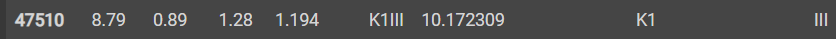

In [ ]:
#unknown_star = ((8.79, 0.89, 1.28, 1.194, 10.172309),)
unknown_star = ((0.89, 1.194, 10.172309),)

#predicted_class = predict(baseline_model, unknown_star)
predicted_class = predict(scaled_model, unknown_star)
print("This star is more than likely a: " + predicted_class)

1/1 [==============================] - 0s 95ms/step
This star is more than likely a: K1III


In [ ]:
def classify(Apparent_Magnitude, Stellar_Parallax, BV_Colour_Index):
  unknown_star = ((Apparent_Magnitude, Stellar_Parallax, BV_Colour_Index),)

  predicted_class = predict(scaled_model, unknown_star)
  answer = "This star is more than likely a: " + predicted_class
  return answer

Classify the star Proxima Centauri:
- Apparent Magnitude: 10.43 – 11.11
- Stellar Parallax: 0.76813"
- B-V Colour index: 1.82

In [ ]:
Apparent_Magnitude = 11
Stellar_Parallax = 0.76813
BV_Colour_Index = 1.82

classify(Apparent_Magnitude, Stellar_Parallax, BV_Colour_Index)

1/1 [==============================] - 0s 115ms/step


'This star is more than likely a: G7Iab'

# References
 - https://towardsdatascience.com/keras-hyperparameter-tuning-in-google-colab-using-hyperas-624fa4bbf673
